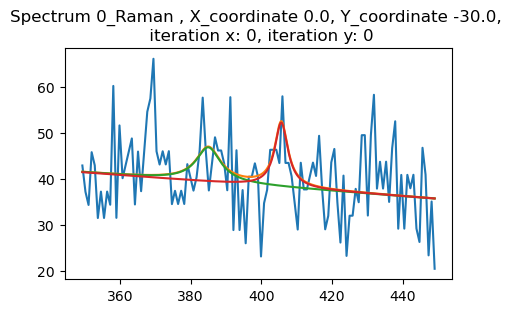

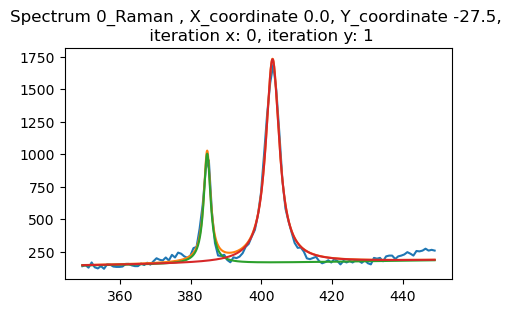

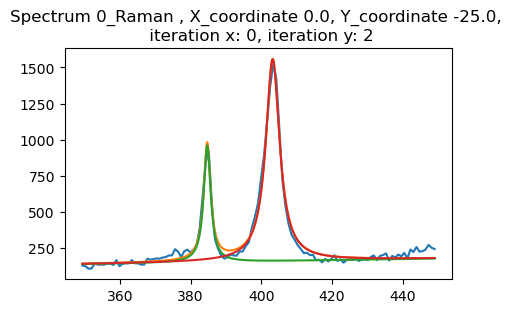

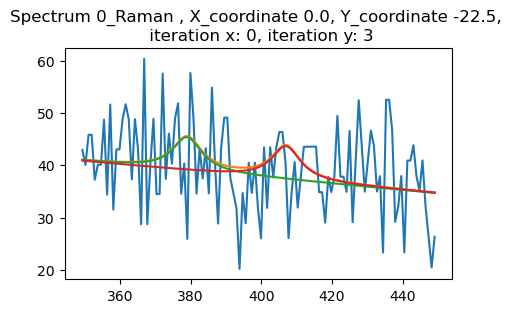

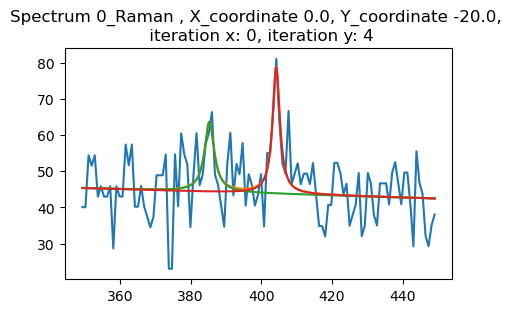

...

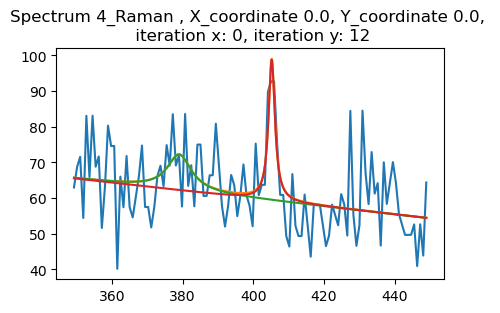

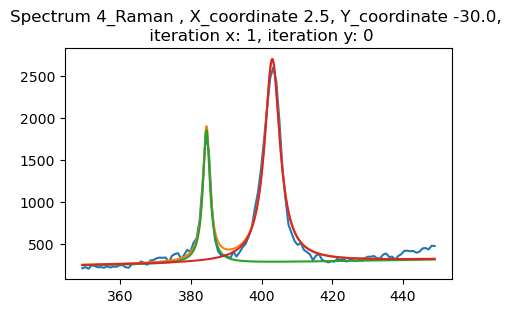

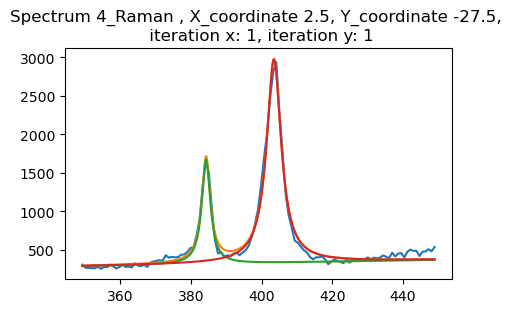

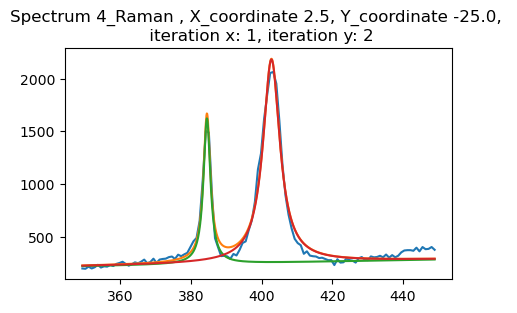

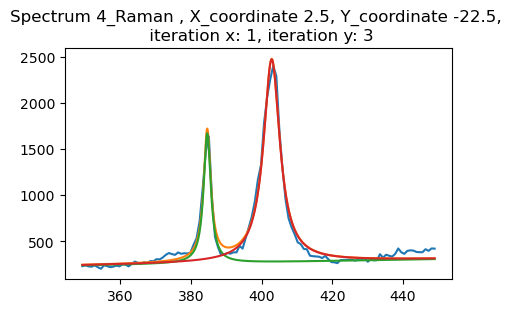

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit

# setting plotting params
plt.rcParams.update({'font.size': 10})
plt.rcParams["figure.figsize"] = (5,3)

# function definitions - we use Lorentz functions to fit the peaks in the Raman spectrum. Depending on the material type
# we will use single Lorentz (e.g. Silicon - Si), double Lorentz (e.g. MoS2 two prominent peaks E2g, A1g) with 532 laser
# multi Lorentz for resonance 5-peak spectrum of WS2 taken with 532 laser
# these peaks are just examples - you can use this script to fit any peaks you need in your Raman statistical analysis.
# Lorentz functions include linear element to them - this is to ensure the right fit to the linear background

def multi_Lorentz(x, a,b, pos1, fwhm1, area1, pos2, fwhm2, area2, pos3, fwhm3, area3, pos4, fwhm4, area4, pos5, fwhm5, area5, pos6, fwhm6, area6):
    return a*x+b+((2*area1/np.pi)*(fwhm1/(4*(x-pos1)**2 + fwhm1**2)))+((2*area2/np.pi)*(fwhm2/(4*(x-pos2)**2 + fwhm2**2)))+((2*area3/np.pi)*(fwhm3/(4*(x-pos3)**2 + fwhm3**2)))+((2*area4/np.pi)*(fwhm4/(4*(x-pos4)**2 + fwhm4**2)))+((2*area5/np.pi)*(fwhm5/(4*(x-pos5)**2 + fwhm5**2)))+((2*area6/np.pi)*(fwhm6/(4*(x-pos6)**2 + fwhm6**2)))

def Lorentz(x, a, b, x_0, w, A):
    return a*x+b+(2*A/np.pi)*(w/(4*(x-x_0)**2 + w**2))

def double_Lorentz(x, a,b, pos1, fwhm1, area1, pos2, fwhm2, area2):
    return a*x+b+((2*area1/np.pi)*(fwhm1/(4*(x-pos1)**2 + fwhm1**2)))+((2*area2/np.pi)*(fwhm2/(4*(x-pos2)**2 + fwhm2**2)))

# Establishing initial parameters for the fit of specific peaks - E2g and A1g based on literature and spectra
# for multi Lorentz fitting additional parameters must be added to maintain the proper formula
init_E2g = [384,2,3000]
init_A1g = [403,4,10000]
initial_parameters = [0,1, init_E2g[0],init_E2g[1],init_E2g[2], init_A1g[0], init_A1g[1], init_A1g[2]]

#initializing arrays for appending fitting parameters - names correspond to specific peaks, thus the naming convention
# name of peak + position (pos), full width at half length (fwhm), intensity/amplitude (amp)
iteration, x_coord, y_coord, E2g_pos, E2g_fwhm, E2g_amp, A1g_pos, A1g_fwhm, A1g_amp, p2LA_pos, p2LA_fwhm, p2LA_amp, Si_pos, Si_fwhm, Si_amp = [],[],[],[],[],[],[],[],[],[],[],[],[],[],[]
E2g2_pos, E2G2_fwhm, E2g2_amp, A1g2_pos, A1g2_fwhm, A1g2_amp, p2LA2_pos, p2LA2_fwhm, p2LA2_amp = [],[],[],[],[],[],[],[],[]
a_fit, b_fit = [], []

#reading in all mapping measurements
raman_dataframes, Si_raman_dataframes = {},{}
filename = 'spectrum_' # filename matched to naming convention of the files, files are enumerated incrementally (0-5)

# Raman mapping coordinates that were selected in the measurement
X_coordinates = np.arange(0, 32.5, 2.5)
Y_coordinates = np.arange(-30, 2.5, 2.5)

# main loop for reading-in files - the examples here are 5 enumerated Raman spectra "spectrum_X.txt" and "Si_X.txt"

for i in range(0,6):
    data = np.loadtxt(filename+str(i)+'.txt', skiprows=1)
    raman_dataframes['raman_'+str(i)]=data 
    data2 = np.loadtxt('Si_'+str(i)+'.txt')
    Si_raman_dataframes['Si_raman_'+str(i)]=data2

#creating dictionary of all raman maps read into
raman_dataframes_dict = {k:pd.DataFrame(v, columns=['X','Y','wave','intensity']) for k,v in raman_dataframes.items()}
Si_raman_dataframes_dict = {k:pd.DataFrame(v, columns=['wave','intensity']) for k,v in Si_raman_dataframes.items()}

# main loop for fitting the measurements and callibration spectra

for i in range(0,6):
    for x in range(0,len(X_coordinates)): #number of X corrdinates
        for y in range(0,len(Y_coordinates)): #number of Y corrdinates
            
            #finding spectrum i of coordinates x,y and performing fitting operations on it
            current_spectrum = raman_dataframes_dict['raman_'+str(i)].loc[(raman_dataframes_dict['raman_'+str(i)]['X'] == float(X_coordinates[x])) & (raman_dataframes_dict['raman_'+str(i)]['Y'] == float(Y_coordinates[y]))]        
            
            #the plotting range [627:743] is where MoS2 main peaks occur, no Si peak for clarity
            # the graphs should be used to check fit quality and the proper execution (no run time error here)
            # a short notice of peak not found or not fitted will show in case of problems with the fit
            
            plt.plot(current_spectrum['wave'][627:743], current_spectrum['intensity'][627:743])
            plt.title('Spectrum ' +str(i)+'_Raman '+', X_coordinate '+str(X_coordinates[x])+', Y_coordinate '+str(Y_coordinates[y])+', \n iteration x: '+str(x)+', iteration y: '+str(y))
            
#             fitting formula with an exception for fit not performed
            try:
                params, corr = curve_fit(double_Lorentz,current_spectrum['wave'][627:743], current_spectrum['intensity'][627:743], initial_parameters, bounds=((-np.inf, 0, 379, 0, 100, 400, 0, 100), (np.inf, np.inf, 387, 10, np.inf, 407, 10, np.inf)))
                a, b, pos1_fitted, fwhm1_fitted, area1_fitted, pos2_fitted, fwhm2_fitted, area2_fitted = params    
            
            except RuntimeError:
                print('ERROR NOT FITTED Raman')
                plt.text(current_spectrum['wave'][627:743].mean(), current_spectrum['intensity'][627:743].mean(),'NOT FITTED')
            
            try:
                params_Si, corr_Si = curve_fit(Lorentz,Si_raman_dataframes_dict['Si_raman_'+str(i)]['wave'][486:533], Si_raman_dataframes_dict['Si_raman_'+str(i)]['intensity'][486:533], [0, 1, 520, 4, 60370])
                a_Si, b_Si, pos_Si, fwhm_Si, area_Si = params_Si    
            
            except RuntimeError:
                print('SI PEAK NOT FOUND!!!')
                plt.text(current_spectrum['wave'][627:743].mean(), current_spectrum['intensity'][627:743].mean(),'SI ALSO NOT FITTED')
            
            
            #plot full spectrum fit with the function that was used - here double Lorentz
            x_fit = np.linspace(current_spectrum['wave'][627:743].min(), current_spectrum['wave'][627:743].max(), 1000)
            y_fit = double_Lorentz(x_fit, a, b, pos1_fitted, fwhm1_fitted, area1_fitted, pos2_fitted, fwhm2_fitted, area2_fitted)
            plt.plot(x_fit, y_fit)
            
            #plot peak 1
            y_fit_E2g = Lorentz(x_fit, a, b, pos1_fitted, fwhm1_fitted, area1_fitted)
            plt.plot(x_fit, y_fit_E2g)
            
            #plot peak 2
            y_fit_A1g = Lorentz(x_fit, a, b, pos2_fitted, fwhm2_fitted, area2_fitted)
            plt.plot(x_fit, y_fit_A1g)
            
            # Adjust the number of peaks to plot and fit as needed for single or multi Lorentz. 
            # You can also fit Voight or combine Gaussian/Lorentzian curves as needed

            # Appending fit parameter's values in a loop to pre-defined tables
            a_fit.append(a)
            b_fit.append(b)
            E2g_pos.append(pos1_fitted)
            E2g_fwhm.append(fwhm1_fitted)
            E2g_amp.append(area1_fitted)
            A1g_pos.append(pos2_fitted)
            A1g_fwhm.append(fwhm2_fitted)
            A1g_amp.append(area2_fitted)
            Si_pos.append(pos_Si)
            Si_fwhm.append(fwhm_Si)
            Si_amp.append(area_Si)
            x_coord.append(X_coordinates[x])
            y_coord.append(Y_coordinates[y])

            # uncomment the line below to save each fitted spectrum
#             plt.savefig('Spectrum ' +filename+str(i)+'_Raman '+', X_coordinate '+str(X_coordinates[x])+', Y_coordinate '+str(Y_coordinates[y])+', iteration x '+str(x)+', iteration y '+str(y)+'.jpg')
            plt.show()
            
            #save data in a new dataframe
            fitted_raman = pd.DataFrame(
            {
            'E2g_pos': E2g_pos,
            'E2g_fwhm': E2g_fwhm,
            'E2g_amp': E2g_amp,
            'A1g_pos': A1g_pos,
            'A1g_fwhm': A1g_fwhm,
            'A1g_amp': A1g_amp,
            'Si_pos': Si_pos,
            'Si_fwhm': Si_fwhm,
            'Si_amp': Si_amp,
            'a': a_fit,
            'b': b_fit,
            'A11_y': y_coord,
            'A11_x': x_coord
            })

            # adding new column to dataframe - difference between postions of A1g and E2g
            fitted_raman['diff_A1g_E2g'] = fitted_raman['A1g_pos']-fitted_raman['E2g_pos']
            # adding new column to dataframe - ratio E2g/Si intensity
            fitted_raman['E2g_to_Si_ratio'] = fitted_raman['E2g_amp']/fitted_raman['Si_amp']
            # adding new column to dataframe - ratio A1g/Si intensity - normalization by referrential Si value
            fitted_raman['A1g_to_Si_ratio'] = fitted_raman['A1g_amp']/fitted_raman['Si_amp']


    CSV_filename = 'parameters_raman_'+str(i)+'.csv'
    fitted_raman.to_csv(filename+'fitted_'+str(i)+'.txt', index=False)


In [2]:
#from fitting above, we take the most important parameters and put them into dataframe

fitted_raman = pd.DataFrame(
    {
    'E2g_pos': E2g_pos,
    'E2g_fwhm': E2g_fwhm,
    'E2g_amp': E2g_amp,
    'A1g_pos': A1g_pos,
    'A1g_fwhm': A1g_fwhm,
    'A1g_amp': A1g_amp,
    'Si_pos': Si_pos,
    'Si_fwhm': Si_fwhm,
    'Si_amp': Si_amp,
    'a': a_fit,
    'b': b_fit
    })

#adding new column to dataframe - difference between postions of A1g and E2g
fitted_raman['diff_A1g_E2g'] = fitted_raman['A1g_pos']-fitted_raman['E2g_pos']
# #adding new column to dataframe - ratio E2g/Si intensity
fitted_raman['E2g_to_Si_ratio'] = fitted_raman['E2g_amp']/fitted_raman['Si_amp']
# #adding new column to dataframe - ratio A1g/Si intensity
fitted_raman['A1g_to_Si_ratio'] = fitted_raman['A1g_amp']/fitted_raman['Si_amp']


CSV_filename = 'parameters_raman_1.csv'
fitted_raman.to_csv(filename+'_NEW_fitted.txt', index=False)

#print dataframe
fitted_raman

,E2g_pos,E2g_fwhm,E2g_amp,A1g_pos,A1g_fwhm,A1g_amp,Si_pos,Si_fwhm,Si_amp,a,b,diff_A1g_E2g,E2g_to_Si_ratio,A1g_to_Si_ratio
0,385.006799,8.510995,100.000000,405.673434,4.534571,100.000000,520.504220,4.420540,96519.370184,-0.057495,6.154437e+01,20.666635,0.001036,0.001036
1,384.683024,2.329988,3097.855988,403.196698,4.600467,11316.687564,520.504220,4.420540,96519.370184,0.406898,2.233389e-19,18.513674,0.032096,0.117248
2,384.691048,2.388939,3039.329442,403.234554,4.741123,10433.816755,520.504220,4.420540,96519.370184,0.387399,1.070549e-17,18.543506,0.031489,0.108101
3,379.000000,10.000000,100.000000,407.000000,10.000000,100.000000,520.504220,4.420540,96519.370184,-0.061671,6.238994e+01,28.000000,0.001036,0.001036
4,385.308447,3.298222,100.000000,404.232429,2.467404,135.894210,520.504220,4.420540,96519.370184,-0.028922,5.545113e+01,18.923983,0.001036,0.001408
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1009,384.053519,2.569984,5729.706666,403.401049,4.359589,18693.354175,520.526059,4.254404,99803.234864,0.656567,2.301326e-13,19.347530,0.057410,0.187302
1010,384.768777,2.224672,4437.622450,403.325707,4.738519,15004.819164,520.526059,4.254404,99803.234864,0.570779,1.997159e-15,18.556930,0.044464,0.150344
1011,384.179591,2.373499,5717.184262,403.345982,4.539005,18405.613252,520.526059,4.254404,99803.234864,0.644429,2.349786e-14,19.166391,0.057285,0.184419
1012,384.157935,2.718734,6209.010363,403.436118,4.330279,18494.723494,520.526059,4.254404,99803.234864,0.662399,3.353794e-17,19.278183,0.062213,0.185312


In [8]:
#data cleaning
for i in range(0,6):
    df = pd.read_csv(filename+'_fitted'+str(i)+'.txt')
    df = df.round(2)
    df = df[df.A1g_amp != 100.00]
    df = df[df.E2g_amp != 100.00]
    df = df[df.E2g_fwhm <= 10.00]
    df = df[df.A1g_fwhm <= 10.00]
    df = df[df.b <= 6.00]
    df = df[df.a <= 0.9]
    df.reset_index()
    df.to_csv('spectrum_'+str(i)+'fitted_clean', index=False)